<a href="https://colab.research.google.com/github/Noam-and-Iftach/DS20936/blob/main/In_progress.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import polars as pl

import pyarrow.parquet as pq
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive/')


Mounted at /content/drive/


In [ ]:
#df=pq.read_table('/content/drive/MyDrive/books_only_style_column.parquet')
#df=pl.read_parquet('/content/drive/MyDrive/books_only_style_column.parquet')
#df=df.to_pandas()
filtered_counts =df['style'].value_counts(sort=True)

In [ ]:

filtered_counts.to_pandas()

,style,count
0,{'Format:': ' Kindle Edition'},17172000
1,{'Format:': ' Paperback'},8129082
2,{'Format:': ' Hardcover'},5152115
3,{'Format:': ' Mass Market Paperback'},1023654
4,None,304997
...,...,...
288,"{'Color:': ' School Pop', 'Format:': None}",1
289,"{'Color:': None, 'Format:': ' Digital'}",1
290,"{'Color:': None, 'Format:': ' Poster', 'Size:'...",1
291,"{'Color:': None, 'Format:': ' Accessory', 'Siz...",1


In [ ]:


one_huge_df_from_kindle_that_came_from_books=pd.d

,Unnamed: 0,style
0,0,{'Format:': ' Paperback'}
1,1,{'Format:': ' Hardcover'}
2,2,{'Format:': ' Hardcover'}
3,3,{'Format:': ' Hardcover'}
4,4,None
...,...,...
8557289,8557289,"{'Color:': None, 'Format:': ' Paperback', 'Siz..."
8557290,8557290,"{'Color:': None, 'Format:': ' Kindle Edition',..."
8557291,8557291,"{'Color:': None, 'Format:': ' Kindle Edition',..."
8557292,8557292,"{'Color:': None, 'Format:': ' Kindle Edition',..."


In [ ]:
filtered_counts=filtered_counts[filtered_counts > 100]
print(filtered_counts)

{'Format:': ' Kindle Edition'}            17172000
{'Format:': ' Paperback'}                  8129082
{'Format:': ' Hardcover'}                  5152115
{'Format:': ' Mass Market Paperback'}      1023654
{'Format:': ' Board book'}                  206655
                                            ...   
{'Format:': ' HD DVD'}                         120
{'Color:': None, 'Format:': ' MP3 CD'}         117
{'Format:': ' DVD-ROM', 'Size:': None}         116
{'Format:': ' Software'}                       115
{'Format:': ' Baby Product'}                   112
Name: style, Length: 143, dtype: int64


[link text](https://)We want to check the same with kindle.style

In [ ]:
import pandas as pd
import pyarrow.parquet as pq



# Specify the base file name and its location
base_file_name = 'kindle-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/kindle-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 1
end_file_number = 287  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
concatenated_df = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    table = pq.read_table(file_path)
    df = table.to_pandas()
    concatenated_df = pd.concat([concatenated_df, df["style"]], ignore_index=True)

# Display the concatenated DataFrame
print(concatenated_df.tail())




```
# This is formatted as code
```

 We took only the first four which are:  Kindle Edition, paperback, Hardcover, Mass Market Paperback.

> Indented block



In [ ]:
concatenated_df.to_csv("/content/drive/MyDrive/kindle_style_only.csv")

In [ ]:
concatenated_df.value_counts()

{'Format:': ' Kindle Edition'}                     5045160
{'Format:': ' Paperback'}                           165154
{'Format:': ' Hardcover'}                            72067
{'Format:': ' Mass Market Paperback'}                10295
{'Format:': ' Audible Audiobook'}                     6455
{'Format:': ' Audio CD'}                              2602
{'Format:': ' Board book'}                            1827
{'Format:': ' Kindle Edition with Audio/Video'}       1429
{'Format:': ' Print Magazine'}                        1116
{'Format:': ' Perfect Paperback'}                      533
{'Format:': ' Leather Bound'}                          463
{'Format:': ' MP3 CD'}                                 419
{'Format:': ' Flexibound'}                             341
{'Format:': ' Comic'}                                  291
{'Format:': ' DVD'}                                    276
{'Format:': ' Spiral-bound'}                           154
{'Format:': ' Library Binding'}                        1

In [ ]:
import pandas as pd
import pyarrow.parquet as pq



# Specify the base file name and its location
base_file_name = 'kindle-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/kindle-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 1
end_file_number = 287  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
concatenated_df = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    table = pq.read_table(file_path)
    df = table.to_pandas()
    concatenated_df = pd.concat([concatenated_df, df], ignore_index=True)

# Display the concatenated DataFrame
print(concatenated_df.tail())


In [ ]:
counting_reviewer_per_time = concatenated_df.groupby(["reviewerID", "unixReviewTime"]).size()

reviewerID            unixReviewTime
A00006301SOXP1JTSSEW  1411430400        1
A000392684P4JNLQRBBW  1446508800        1
A0004870ERG4H2S4AOVF  1415059200        1
                      1417910400        1
A0010876CNE3ILIM9HV0  1362787200        1
                                       ..
AZZZIHJUK56AQ         1362355200        1
AZZZK1LR0MJRB         1433548800        1
AZZZMSZI9LKE6         1330473600        1
AZZZOCO892MI5         1408665600        1
AZZZTAPYKI9RD         1414368000        1
Length: 5031222, dtype: int64

In [ ]:
counting_reviewer_per_time_sorte = concatenated_df.groupby(["reviewerID", "unixReviewTime"]).size().reset_index(name='counts').sort_values(by='counts', ascending=False)

In [ ]:
counting_reviewer_per_time_sorte.head()

,reviewerID,unixReviewTime,counts
4903806,AWHX7AT8548LB,1453593600,163
4683173,AQBTNZ9ZD08PD,1499990400,134
3781289,A3TY31K1VXAGSX,1443139200,132
2377560,A2S16KJUW9MAOR,1412380800,106
1487995,A23SB7XAREYGF2,1468800000,99


In [ ]:
reviewer_with_99_same_time = concatenated_df.loc[(concatenated_df["reviewerID"] == "A23SB7XAREYGF2") &
                                                 (concatenated_df["unixReviewTime"] == 1468800000)]

In [ ]:
counting_reviewer_per_time_sorte.unixReviewTime.dtype

dtype('int64')

In [ ]:
reviewer_with_99_same_time.to_csv("/content/drive/MyDrive/special_reviwer.csv")

We asked ourselves, is it possible that he had rated 5 for all the books, beacuse here we got only the books that were in the same time.

In [ ]:
reviewer_with_99 = concatenated_df.loc[(concatenated_df["reviewerID"] == "A23SB7XAREYGF2")]

In [ ]:
reviewer_with_99.overall.describe()

count    121.0
mean       5.0
std        0.0
min        5.0
25%        5.0
50%        5.0
75%        5.0
max        5.0
Name: overall, dtype: float64

# We saw that all of it's reviews has overall of 5.

We want to take from the kindle only the kindle style, and from the books the first four, and from each of them we want to take only reviewer that has at least 10 from that style.

And we want to drop the following colomns: reviewTime, unixReviewTime, image

(אם יש מישהו שעשה reviews
בשניהם ויש לו 10 ביחד אנחנו לא נספור אותו\)

since the major category in books.json was kindle, we decided to transfer this records onto the kindle dataframe, in order to correctly filter above count of 10

In [ ]:
import pandas as pd
import pyarrow.parquet as pq
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive/')
#reading entire book dataset, filtering out only the kindle style, then concat to kindle dataset, while alo keping only the 3 top styles other than kindle
#1st part
# Specify the base file name and its location
base_file_name = 'output_chunk_{}.parquet'
file_location = '/content/drive/MyDrive/books-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 901
end_file_number = 1027  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
df_kindle_concatenated = pd.DataFrame()
df_books_concatenated = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    df=df.drop(columns=['reviewTime', 'unixReviewTime', 'image'])
    df['vote'] = df['vote'].astype(str)
    df["asin"] = df["asin"].astype(str)

    df_kindle = (df[df['style'].astype(str) == "{'Format:': ' Kindle Edition'}"])
    df_books = df[df['style'].astype(str).isin(["{'Format:': ' Paperback'}", "{'Format:': ' Hardcover'}", "{'Format:': ' Mass Market Paperback'}"])]

    df_kindle_concatenated = pd.concat([df_kindle_concatenated, df_kindle], ignore_index=True)
    df_books_concatenated = pd.concat([df_books_concatenated, df_books], ignore_index=True)

df_kindle_concatenated.to_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/kindle_7.parquet")
df_books_concatenated.to_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_7.parquet")



Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
file number:  901
file number:  902
file number:  903
file number:  904
file number:  905
file number:  906
file number:  907
file number:  908
file number:  909
file number:  910
file number:  911
file number:  912
file number:  913
file number:  914
file number:  915
file number:  916
file number:  917
file number:  918
file number:  919
file number:  920
file number:  921
file number:  922
file number:  923
file number:  924
file number:  925
file number:  926
file number:  927
file number:  928
file number:  929
file number:  930
file number:  931
file number:  932
file number:  933
file number:  934
file number:  935
file number:  936
file number:  937
file number:  938
file number:  939
file number:  940
file number:  941
file number:  942
file number:  943
file number:  944
file number:  945
file number:  946
file number:  947
file number:  948
file 

In [ ]:
df_kindle['asin'].dtype

dtype('O')

In [ ]:
df_kindle_concatenated.to_csv("/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/kindle_1.csv",escapechar='\\', index=False)
df_books_concatenated.to_csv("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_1.csv",escapechar='\\', index=False)

In [ ]:
df_kindle_concatenated['asin'] = df_kindle_concatenated['asin'].astype(str)
df_books_concatenated['asin'] = df_books_concatenated['asin'].astype(str)

df_kindle_concatenated.to_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/kindle_4.parquet")
df_books_concatenated.to_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_4.parquet")

In [ ]:
# Filter by 'style'
filtered_df = concatenated_df[concatenated_df['style'] == "{'Format:': ' Kindle Edition'}"]

# Drop the unnecessary columns
filtered_df = filtered_df.drop(columns=['reviewTime', 'unixReviewTime', 'image'])

# Group by 'reviewerID' and count the reviews
review_counts = filtered_df.groupby('reviewerID').size()

# Filter to get reviewers with at least 10 reviews
reviewers_with_10_plus = review_counts[review_counts >= 10].index

# Get records of these reviewers from the filtered DataFrame
result_df = filtered_df[filtered_df['reviewerID'].isin(reviewers_with_10_plus)]

# Now result_df contains the filtered records
print(result_df)

         overall  verified      reviewerID        asin  \
17             4      True  A2LSKD2H9U8N0J  B000FA5KK0   
18             5      True  A2QP13XTJND1QS  B000FA5KK0   
29             5      True   A1E0MODSRYP7O  B000FA5KK0   
32             5      True   AYUTCGVSM1H7T  B000FA5KK0   
35             5      True   A9DXGM6YGV14D  B000FA5KK0   
...          ...       ...             ...         ...   
5722972        5     False  A38NOWP7LQI8CM  B01HJENY3Y   
5722974        5      True   AGBVBXSAJDD4H  B01HJENY3Y   
5722976        4      True  A28D20IM3BNAJ1  B01HJDS9W6   
5722981        5      True  A16WVTYTORKVCL  B01HJH8CDS   
5722982        4      True  A3GBIVLK7ZBI38  B01HJH82WY   

                                  style         reviewerName  \
17       {'Format:': ' Kindle Edition'}  sandra sue marsolek   
18       {'Format:': ' Kindle Edition'}                  Tpl   
29       {'Format:': ' Kindle Edition'}                 Jeff   
32       {'Format:': ' Kindle Edition'}    DEHS

In [ ]:
reviewers_with_more_than_10 = review_counts[review_counts >= 10]

print(reviewers_with_more_than_10.sort_values(ascending=False))

reviewerID
A328S9RN3U5M68    1741
A13QTZ8CIMHHG4    1423
A1JLU5H1CCENWX    1380
A2W4Z0J9DFZFSR    1101
A3GWE80SUGORJD    1006
                  ... 
A1PAZDZXQ2DFBD      10
A2YJB7360UNS8L      10
A2FBDKWOHJ2OO1      10
A6M59OCSHZXCG       10
A2VJ1KQ9UZWFYU      10
Length: 63430, dtype: int64


In [ ]:
import plotly.express as px

# Create a histogram / bin graph of the review counts with a bin width of 50 using Plotly Express
fig = px.histogram(reviewers_with_more_than_10, x=reviewers_with_more_than_10.values,
                   nbins=int(reviewers_with_more_than_10.max() / 25),
                   labels={'x': 'Review Counts', 'y': 'Number of Reviewers'},
                   title='Distribution of Review Counts per Reviewer')

# Update layout for clarity
fig.update_layout(bargap=0.2)
fig.show()


In [ ]:
result_df.to_csv("/content/drive/MyDrive/kindle_10_plus_reviwers.csv")

Now we will filter in the same way for books.json

In [ ]:

# Specify the base file name and its location
base_file_name = 'output_chunk_{}.parquet'
file_location = '/content/drive/MyDrive/books-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 1
end_file_number = 1027  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
concatenated_df = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    concatenated_df = pd.concat([concatenated_df, df], ignore_index=True)

# Display the concatenated DataFrame
print(concatenated_df.tail())


file number:  1
file number:  2
file number:  3
file number:  4
file number:  5
file number:  6
file number:  7
file number:  8
file number:  9
file number:  10
file number:  11
file number:  12
file number:  13
file number:  14
file number:  15
file number:  16
file number:  17
file number:  18
file number:  19
file number:  20
file number:  21
file number:  22
file number:  23
file number:  24
file number:  25
file number:  26
file number:  27
file number:  28
file number:  29
file number:  30
file number:  31
file number:  32
file number:  33
file number:  34
file number:  35
file number:  36
file number:  37
file number:  38
file number:  39
file number:  40
file number:  41
file number:  42


KeyboardInterrupt: 

We split the books.json into 14 files, seperated into kindle format and 3 other books formats, now we will use the first book parquet file only, and build the model with it, and later on we will test it on other parts

In [ ]:
first_book = pd.read_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_1.parquet", engine='pyarrow')

We will start by viewing how many duplicates are there in books_1 and how many null values

In [ ]:
first_book.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3739821 entries, 0 to 3739820
Data columns (total 9 columns):
 #   Column        Dtype 
---  ------        ----- 
 0   overall       int64 
 1   verified      bool  
 2   reviewerID    object
 3   asin          object
 4   style         object
 5   reviewerName  object
 6   reviewText    object
 7   summary       object
 8   vote          object
dtypes: bool(1), int64(1), object(7)
memory usage: 231.8+ MB


In [ ]:
first_book.describe().round(2)


,overall
count,3739821.00
mean,4.29
std,1.15
min,1.00
25%,4.00
50%,5.00
75%,5.00
max,5.00


In [ ]:
first_book.apply(lambda col: col.isna().sum())


overall           0
verified          0
reviewerID        0
asin              0
style             0
reviewerName    135
reviewText      899
summary         430
vote              0
dtype: int64

In [ ]:
column_details = [(column, first_book[column].nunique(), first_book[column].dtype) for column in first_book.columns if column != "style"]
column_summary_df = pd.DataFrame(column_details, columns=['feature name', 'unique', 'type'])
print(column_summary_df)

   feature name   unique    type
0       overall        5   int64
1      verified        2    bool
2    reviewerID  2120679  object
3          asin    70325  object
4  reviewerName  1416147  object
5    reviewText  3485673  object
6       summary  2308730  object
7          vote     1562  object


In [ ]:
first_book.head()

,overall,verified,reviewerID,asin,style,reviewerName,reviewText,summary,vote
0,5,False,A1C6M8LCIX4M6M,0001713353,{'Format:': ' Paperback'},June Bug,This book is a winner with both of my boys. T...,Children's favorite,None
1,5,False,A1REUF3A1YCPHM,0001713353,{'Format:': ' Hardcover'},TW Ervin II,"The King, the Mice and the Cheese by Nancy Gur...",A story children will love and learn from,None
2,5,False,A1YRBRK2XM5D5,0001713353,{'Format:': ' Hardcover'},Rebecca L. Menner,My daughter got her first copy from her great-...,Third copy,5
3,5,False,A1V8ZR5P78P4ZU,0001713353,{'Format:': ' Hardcover'},Mindy Stone,I remember this book from when I was a child a...,Graphically Wonderful!,None
4,5,True,ACPQVNRD3Z09X,0001713353,{'Format:': ' Hardcover'},Terri Dickson,It is a very cute book with great illustration...,Five Stars,None


In [ ]:
first_book.apply(lambda col: col.isin(["nan", "NaN", "None"]).sum())


overall               0
verified              0
reviewerID            0
asin                  0
style                 0
reviewerName        118
reviewText           86
summary              20
vote            2548621
dtype: int64

We can see that out of 3.4 million reviews, most of the vote values are None, and we barely have values in the colomns: summary, reviewText. We decided to discarded the vote since it doesn't provide additional information, and also reviewerName, since the system will recommand based on the reviwerID

In [ ]:
import numpy as np
# Assuming first_book is your original DataFrame
# Create a copy of the original DataFrame
first_book_after_preprocessing = first_book.copy()
first_book_after_preprocessing.drop(columns=["vote", "reviewerName"], inplace=True)

# Convert "nan", "NaN", "None", and empty strings to np.nan in the new DataFrame
first_book_after_preprocessing.replace(["nan", "NaN", "None", ""], np.nan, inplace=True)

# Drop rows with any np.nan values in the new DataFrame
first_book_after_preprocessing.dropna(inplace=True)

# Drop specific columns in the new DataFrame


In [ ]:
first_book_after_preprocessing.head()

,overall,verified,reviewerID,asin,style,reviewText,summary
2,5,False,A1YRBRK2XM5D5,0001713353,{'Format:': ' Hardcover'},My daughter got her first copy from her great-...,Third copy
28,5,False,A1VU0P0OF9DRMT,0001713353,{'Format:': ' Hardcover'},My mother first read this book to me when I wa...,One of my favorite children's books!
30,5,False,AC4I57VYBGO8P,0001713353,{'Format:': ' Hardcover'},One of the best books I have ever read. The m...,Brilliant illustration of the Law of Unintende...
31,4,False,AKHVEPR68DGPN,0001713353,{'Format:': ' Paperback'},This was one of my favorite books since I was ...,Good Book
32,5,False,A189H5MS7ECVRX,0001713353,{'Format:': ' Paperback'},This is a wonderful story and both my 5yo and ...,A snowballing problem...


In [ ]:
first_book_after_preprocessing["style"] = first_book_after_preprocessing["style"].astype(str)

In [ ]:
first_book_after_preprocessing.shape

(3738407, 7)

In [ ]:
print(first_book_after_preprocessing.duplicated().sum())


3356


In [ ]:
# Identify all duplicate rows, including their first occurrence
duplicates = first_book_after_preprocessing.duplicated(keep=False)

# Filter the DataFrame to view only the duplicate rows
duplicate_rows = first_book_after_preprocessing[duplicates]

print(duplicate_rows.head())
print(first_book_after_preprocessing.shape)

      overall  verified      reviewerID        asin  \
1007        5     False   AN4RKQM9AYVAD  0001384198   
1008        5     False   AN4RKQM9AYVAD  0001384198   
1170        5      True  A3IVT3UA3ZERWQ  0001381733   
1171        5      True  A3IVT3UA3ZERWQ  0001381733   
1195        5      True  A3PYRSATCV6329  0001381733   

                          style  \
1007  {'Format:': ' Hardcover'}   
1008  {'Format:': ' Hardcover'}   
1170  {'Format:': ' Hardcover'}   
1171  {'Format:': ' Hardcover'}   
1195  {'Format:': ' Hardcover'}   

                                             reviewText  \
1007  I liked this book because it motivated me to d...   
1008  I liked this book because it motivated me to d...   
1170                                        Excellent!!   
1171                                        Excellent!!   
1195                                             A gift   

                                          summary  
1007  This book is good for anyone who have kids.  

In [ ]:
duplicate_rows.head()

,overall,verified,reviewerID,asin,style,reviewText,summary
1007,5,False,AN4RKQM9AYVAD,0001384198,{'Format:': ' Hardcover'},I liked this book because it motivated me to d...,This book is good for anyone who have kids.
1008,5,False,AN4RKQM9AYVAD,0001384198,{'Format:': ' Hardcover'},I liked this book because it motivated me to d...,This book is good for anyone who have kids.
1170,5,True,A3IVT3UA3ZERWQ,0001381733,{'Format:': ' Hardcover'},Excellent!!,Excellent!!
1171,5,True,A3IVT3UA3ZERWQ,0001381733,{'Format:': ' Hardcover'},Excellent!!,Excellent!!
1195,5,True,A3PYRSATCV6329,0001381733,{'Format:': ' Hardcover'},A gift,Five Stars


In [ ]:
# Group by 'reviewerID' and 'asin', then count the number of reviews for each group
reviews_count = first_book_after_preprocessing.groupby(['reviewerID', 'asin']).size().reset_index(name='number_of_reviews').sort_values(by='number_of_reviews', ascending=False)



In [ ]:
reviews_count.head()

,reviewerID,asin,number_of_reviews
352820,A1D2C0WDCSHUWZ,0007350783,74
1798904,A2TXR85WQLE32N,0140324623,57
352774,A1D2C0WDCSHUWZ,000711835X,48
352742,A1D2C0WDCSHUWZ,0001048767,46
902721,A1X4JO8EJ1U5BR,0007284241,26


In [ ]:
sum_reviews = (reviews_count[reviews_count["number_of_reviews"] > 1])["number_of_reviews"].sum()

In [ ]:
sum_reviews

49911

In [ ]:
# Filter the DataFrame for rows with the specified 'reviewerID' and 'asin'
filtered_df = first_book_after_preprocessing[(first_book_after_preprocessing['reviewerID'] == 'A1D2C0WDCSHUWZ') & (first_book_after_preprocessing['asin'] == '0007350783')]

# Define the CSV file name
csv_file_name = 'filtered_reviews.csv'

# Save the filtered DataFrame to a CSV file
filtered_df.to_csv(csv_file_name, index=False)

# Output the path to the saved CSV file for download or further reference
csv_file_name


'filtered_reviews.csv'

We saw that there are many reviews for the same book by same reviewer that are different, so we checked in amazon:
https://www.amazon.com/Emma-Be-Classics-Jane-Austen/dp/0142419680

https://www.amazon.com/Emma-Knickerbocker-Classics-Jane-Austen/dp/1631060708
https://www.amazon.ca/product-reviews/B0C1KX3MQQ/ref=zg_bsnr_1051378_cr_sccl_1/000-0000000-0000000


By searching amazon for the review that has different text in it, we see that the reviewer did write that review, however, it was written on a different book by the same author.
https://www.amazon.com.au/Northanger-Abbey-Jane-Austen-ebook/dp/B07XXWBYX6

We see that for the same reviewerID, and same asin there are different reviews, which while searching the web shows us different books. The question is whether we can tell which book is really the one that the reviewer had reviewed using the metadata file.

[link text](https://)Let's see which book is this by viewing the asin in the metadata file:

In [ ]:
# Specify the base file name and its location
base_file_name = 'meta-books-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/meta-books-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 1
end_file_number = 147  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
meta_books_df = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    if file_number%10==0:
      print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    meta_books_df = pd.concat([meta_books_df, df], ignore_index=True)

# Display the concatenated DataFrame
print(meta_books_df.tail())

file number:  10
file number:  20
file number:  30
file number:  40
file number:  50
file number:  60
file number:  70
file number:  80
file number:  90
file number:  100
file number:  110
file number:  120
file number:  130
file number:  140
                                                  category tech1 description  \
2934944  ['Books', 'Mystery, Thriller & Suspense', 'Thr...  None          []   
2934945       ['Books', 'Literature & Fiction', 'Erotica']  None          []   
2934946                                                 []  None          []   
2934947  ['Books', 'Religion & Spirituality', 'New Age ...  None          []   
2934948                                                 []  None          []   

         fit                                              title  \
2934944  NaN  Made Men: A Thriller (Law of Retaliation Book ...   
2934945  NaN  Raptor&#39;s Desire (A Planet Desire novelette...   
2934946  NaN  LG K4 Case,LG Optimus Zone 3 Case,LG Spree Cas...   
2934947 

In [ ]:
filtered_rows = meta_books_df[meta_books_df['asin'] == '0007350783']

In [ ]:
filtered_rows

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN


In [ ]:
filtered_rows = meta_books_df[meta_books_df['title'].str.contains("Emma", case=False, na=False)]

In [ ]:
filtered_rows

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
2846,"['Books', 'Biographies & Memoirs']",NaN,['`One of the best (books) I have ever read on...,NaN,"Emma's War: Love, Betrayal and Death in the Sudan","['0307385906', '0812968859', '178453644X', '15...",NaN,Visit Amazon's Deborah Scroggins Page,[],"12,801,197 in Books (","['0812968859', '0307385906', '0316548189', '17...",Books,NaN,NaN,.a-section.a-spacing-mini{margin-bottom:6px!im...,0006551475,[],[],NaN
4759,"['Books', 'Arts & Photography', 'Performing Ar...",NaN,[],NaN,Undressing Emmanuelle: A Memoir,['B000TXPXAU'],NaN,Visit Amazon's Sylvia Kristel Page,[],"1,914,793 in Books (",[],Books,NaN,NaN,None,0007256957,[],[],NaN
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN
7438,[],NaN,"['', '']",NaN,EDITING EMMA- NOT-US CA PB,[],NaN,CHLOE SEAGER,[],"4,572,731 in Books (",[],Books,NaN,NaN,$11.53,0008220972,[],[],NaN
7858,"['Books', 'Literature &amp; Fiction', 'Contemp...",NaN,['Artie Hobson here describes the slow decline...,NaN,Prisoner's Dilemma (Collier Fiction),"['0060975008', '0060975091', '0312423136', '03...",NaN,Visit Amazon's Richard Powers Page,[],"17,164,578 in Books (","['039363552X', '0393349845', '0060975091', '00...",Books,NaN,NaN,$14.95,002036055X,[],[],NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2921003,"['Books', 'Medical Books', 'Medicine', '</span>']",None,[],NaN,Clinical Dilemmas in Non-Alcoholic Fatty Live...,[],NaN,Roger Williams,[],"3,493,749 Paid in Kindle Store (",[],Buy a Kindle,None,None,None,B01BWM40AA,[],[],"{'File Size:': '22388 KB', 'Print Length:': '2..."
2923241,[],None,[],NaN,"Life and Work in Middlebury, Vermont, of Emma ...",[],NaN,Ezra Brainerd,[],"5,930,388 in Books (",[],Books,None,None,$9.95,B01D16F02C,[],[],"{'Paperback:': '28 pages', 'Publisher:': 'Leop..."
2929244,[],None,[],NaN,His Five Night Stand: A Bedroom Secrets Romanc...,[],NaN,None,[],[],[],Books,None,None,$23.16,B01FGK36FO,[],[],{'Publisher:': 'Indie Publishing Group (1808)'...
2931466,"['Books', 'Literature & Fiction', 'Genre Ficti...",None,[],NaN,Political Murder: An Elizabeth Thatcher Myster...,"['B01HYBVT8Y', 'B075FJJ545', 'B075PZFJFQ', 'B0...",NaN,Emma Lathen,[],"1,007,642 Paid in Kindle Store (","['B01HYBVT8Y', 'B01M0C9F1I']",Buy a Kindle,None,None,None,B01FZKDXTY,[],[],"{'File Size:': '764 KB', 'Print Length:': '67 ..."


WE will check for the author Jane Austen whether it is in the brand or description colomn:

In [ ]:
filtered_rows = meta_books_df[ meta_books_df['brand'].str.contains("Jane Austen", case=False, na=False) & meta_books_df['title'].str.contains("Emma", case=False, na=False) ]

In [ ]:
filtered_rows

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes,details
5617,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['', 'Jane Austen (17751817) was an English no...",NaN,Emma (Collins Classics),"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"625,123 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$3.99,0007350783,[],[],NaN
104629,"['Books', 'Humor & Entertainment', 'Humor']",NaN,['&quot;Jane Austen is my favorite author! ......,NaN,Emma: 200th-Anniversary Annotated Edition (Pen...,"['0141439688', '0141439661', '0141439807', '01...",NaN,Visit Amazon's Jane Austen Page,[],"200,608 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,$14.24,0143107712,[],[],NaN
181514,"['Books', 'Literature &amp; Fiction', 'History...",NaN,"['', '<b>Jane Austen</b> (17751817) was born i...",NaN,The Annotated Emma,"['0307390802', '0307390780', '0307390764', '03...",NaN,Jane Austen,[],"83,379 in Books (","['0141439580', '0307950905', '0307390799', '03...",Books,None,None,$15.28,0307390772,[],[],NaN
297270,"['Books', 'Literature &amp; Fiction', 'History...",NaN,"['', '<strong>Jane Austen</strong> (17751817) ...",NaN,Emma (Fourth Edition) (Norton Critical Editions),"['0141439688', '0141439807', '0141439661', '01...",NaN,Jane Austen,[],"263,966 in Books (","['0141439513', '0141439661', '1514696886', '01...",Books,NaN,NaN,None,0393927644,[],[],NaN
297590,"['Books', 'Literature &amp; Fiction', 'Classics']",NaN,"[""Emma (1816) is Jane Austen's most characteri...",NaN,Emma: An Authoritative Text Backgrounds Review...,"['0141439807', '0141439688', '0141439513', '01...",NaN,Jane Austen,[],"1,992,262 in Books (","['0141439580', '0141439793']",Books,NaN,NaN,None,0393960145,[],[],NaN
394033,"['Books', 'Teen &amp; Young Adult', 'Literatur...",NaN,"['', '']",NaN,Emma (Dover Thrift Study Edition),"['0141439688', '0141439807', '0141439661', '01...",NaN,Visit Amazon's Jane Austen Page,[],"2,678,147 in Books (","['0141439513', '1514696886', '0141439688', '01...",Books,NaN,NaN,$6.95,0486478041,[],[],NaN
447108,"['Books', 'Literature &amp; Fiction', 'Dramas ...",None,"['""Jane Austen is my favorite author! ... Shut...",NaN,Emma (Bantam Classics),"['1593080492', '0553212761', '0451530837', '04...",NaN,Visit Amazon's Jane Austen Page,[],"485,817 in Books (","['0141439513', '1514696886', '0141439688', '01...",Books,NaN,None,$5.95,0553212737,[],[],NaN
545313,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['""How Jane Austen can write!...She is a minia...",NaN,"The Complete Novels of Jane Austen, Vol. 2 (Em...","['0679600264', '0465019315']",NaN,Visit Amazon's Jane Austen Page,[],"1,628,591 in Books (","['0679600264', '0143039504', '0141439580']",Books,NaN,NaN,$2.00,0679600256,[],[],NaN
684514,"['Books', 'Literature &amp; Fiction', 'Classics']",None,['In a publishing career that spanned less tha...,NaN,Jane Austen: Complete and Unabridged (Sense an...,"['076077501X', '0760793239', '0760774005', '07...",NaN,Jane Austen,[],"867,254 in Books (","['0141439661', '0785834214', '0143039504', '16...",Books,None,None,$12.00,0760774013,[],[],NaN
935809,"['Books', 'Literature & Fiction', 'Classics']",NaN,"['Book by Austen, Jane']",NaN,"Northanger Abbey, Persuasion &amp; Emma (Golde...",[],NaN,Jane Austen,[],"1,235,207 in Books (","['0141439688', '0141439807']",Books,NaN,None,$28.30,0861366050,[],[],NaN


In [ ]:
del meta_books_df

Regarding that question, we can't tell which book was it right now, since for same book there are multiple asin, and in the reviews file we saw that for same asin there are multiplte books. Therefore, after we saw that there are only 22K of reviews that has more than one review for the same book, we decided to drop them.

In [ ]:
len(reviews_count[reviews_count['number_of_reviews']>1])

22503

# First Book

In [ ]:
review_counts = first_book_after_preprocessing.groupby(['reviewerID', 'asin']).transform('count')

# Find rows where the count of reviews for the combination is exactly 1
single_reviews = review_counts.max(axis=1) == 1

# Filter the DataFrame to keep only those rows
first_book_single_reviews = first_book_after_preprocessing[single_reviews]

In [ ]:
first_book_single_reviews.to_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/first_book_after_preprocessing.parquet")

In [ ]:
first_book_single_reviews.shape

(3688496, 7)

*Lets* see how many reviewer ID are now (how many books each reviewer has reviewed):

In [ ]:
review_counts_per_reviewer = first_book_single_reviews["reviewerID"].value_counts()


In [ ]:
first_book_single_reviews["style"] = first_book_single_reviews["style"].astype(str)
first_book_single_reviews[(first_book_single_reviews['reviewerID'] == 'A2F6N60Z96CAJI') ].nunique().reset_index(name='unique_name_count')


<ipython-input-13-e444e4b22369>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  first_book_single_reviews["style"] = first_book_single_reviews["style"].astype(str)


,index,unique_name_count
0,overall,5
1,verified,1
2,reviewerID,1
3,asin,3090
4,style,3
5,reviewText,3089
6,summary,3085


In [ ]:
(review_counts_per_reviewer > 9).sum()


26687

In [ ]:
first_book_single_reviews["reviewerID"].nunique()

2114988

In [ ]:
first_book_single_reviews_asin_counts=first_book_single_reviews['asin'].value_counts()

In [ ]:
(first_book_single_reviews_asin_counts> 9).sum()

45037

Remember for all 7 files to run the 2 snippents from here that remove: 1. vote, reviewerName colomns and none values, and  2. For every "duplicate" review that has for the same reviewerID and asin, different reviews, since we can't tell which one is the correct, drop them all.

##
מחשבות להמשך-
שלב 1:
לעידן-


איך לפלטר ולמה

גרפים של

EDA

איך מריצים מחדש

שלב 2:
recomandation system in batches



נבדוק רגע את נקודת הasin
כי בסופו של דבר בשביל מערכת המלצה חייבים מזהה חד חד ערכי עבור ספר מסויים


In [ ]:
import pandas as pd
import pyarrow.parquet as pq
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive/')
#first_book = pd.read_parquet("/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_1.parquet", engine='pyarrow')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
name_counts = first_book.groupby('reviewerID')['reviewerName'].agg(nunique='nunique', names='unique')


# Filter to keep only those rows where 'nunique' is greater than 1
multiple_names = name_counts[name_counts['nunique'] > 1]

In [ ]:
multiple_names

NameError: name 'multiple_names' is not defined

In [ ]:
# Specify the base file name and its location
base_file_name = 'meta-books-csv-chunk_{}.parquet'
file_location = '/content/drive/MyDrive/meta-books-parquet/'  # Update this with the actual path

# Specify the range of file numbers you want to include
start_file_number = 1
end_file_number = 147  # Adjust this based on your actual file range

# Initialize an empty DataFrame to store the concatenated data
meta_books_df = pd.DataFrame()

# Loop through each file number and append its data to the concatenated DataFrame
for file_number in range(start_file_number, end_file_number + 1):
    if file_number%10==0:
      print("file number: ",file_number)
    file_path = file_location + base_file_name.format(file_number)
    df = pd.read_parquet(file_path)
    meta_books_df = pd.concat([meta_books_df, df], ignore_index=True)



file number:  10
file number:  20
file number:  30
file number:  40
file number:  50
file number:  60
file number:  70
file number:  80
file number:  90
file number:  100
file number:  110
file number:  120
file number:  130
file number:  140


In [ ]:
meta_books_df.head()

,category,tech1,description,fit,title,also_buy,tech2,brand,feature,rank,also_view,main_cat,similar_item,date,price,asin,imageURL,imageURLHighRes
0,[],NaN,['It is a biology book with God&apos;s perspec...,NaN,Biology Gods Living Creation Third Edition 10 ...,"['0669009075', 'B000K2P5SA', 'B00MD4G2N0', 'B0...",NaN,Keith Graham,[],"1,349,781 in Books (","['0019777701', 'B000AUCX7I', 'B000K2P5SA', 'B0...",Books,NaN,NaN,$39.94,0000092878,[],[]
1,"['Books', 'New, Used & Rental Textbooks', 'Med...",NaN,[],NaN,Mksap 16 Audio Companion: Medical Knowledge Se...,[],NaN,Acp,[],"1,702,625 in Books (","['B01MUCYEV7', 'B01KUGTY6O']",Books,NaN,NaN,None,000047715X,[],[]
2,"['Books', 'Arts & Photography', 'Music']",NaN,"['Discography of American Punk, Hardcore, and ...",NaN,"Flex! Discography of North American Punk, Hard...",[],NaN,Burkhard Jarisch,[],"6,291,012 in Books (",[],Books,NaN,NaN,$199.99,0000004545,[],[]
3,"['Books', 'Arts & Photography', 'Music']",NaN,['This is a collection of classic gospel hymns...,NaN,Heavenly Highway Hymns: Shaped-Note Hymnal,[],NaN,Stamps/Baxter,[],"2,384,057 in Books (","['0006180116', '0996092730', 'B000QFOGY0', 'B0...",Books,NaN,NaN,None,0000013765,[],[]
4,[],NaN,[],NaN,Georgina Goodman Nelson Womens Size 8.5 Purple...,[],NaN,None,[],"11,735,726 in Books (",[],Books,NaN,NaN,$164.10,0000000116,[],[]


In [ ]:
multiple_asins = meta_books_df.groupby('asin')['title'].agg(nunique='nunique', names='unique')

multiple_asins = multiple_asins[multiple_asins['nunique'] > 1]

In [ ]:
multiple_asins

,nunique,names
asin,,


In [ ]:
emma_books = meta_books_df[meta_books_df['title'].fillna('').str.startswith('Emma')]


In [ ]:
emma_books.sort_values(by="title").head(81)

In [ ]:
import re
meta_books_df['title'] = meta_books_df['title'].str.replace(r'\s*\([^)]*\)', '', regex=True)
def extract_author(brand):
    if isinstance(brand, str):
        match = re.search(r"Visit Amazon's (.+?) Page", brand)
        return match.group(1) if match else brand

meta_books_df['brand'] = meta_books_df['brand'].apply(extract_author)


In [ ]:
# Group by 'reviewerID', aggregate to get the count of unique names and the names themselves
same_books = meta_books_df.groupby(['brand', 'title']).size()

# Convert the series to a DataFrame and reset the index
same_books = same_books.reset_index()

# Rename the columns appropriately
same_books.columns = ['brand', 'title', 'count']

# Filter to find entries with more than one occurrence
same_books = same_books[same_books['count'] > 1]


In [ ]:
same_books.sort_values(by="count", ascending=False)

,brand,title,count
2618416,Tom Taylor,Injustice,39
1731079,Mark Jones,Top Ten Sights,34
1287000,Johanna Spyri,Heidi,32
280994,Bram Stoker,Dracula,29
1482589,Kenneth Grahame,The Wind in the Willows,26
...,...,...,...
979989,Ha Jin,War Trash,2
979684,HOUGHTON MIFFLIN HARCOURT,"Math Expressions, Grade 5 Student Activity Boo...",2
979681,HOUGHTON MIFFLIN HARCOURT,"Math Expressions, Grade 3 Homework and Remembe...",2
979652,HOUGHTON MIFFLIN HARCOURT,Journeys: Student Edition Grade 4 2017,2


In [ ]:
same_books["count"].sum(), len(meta_books_df)

(68913, 2934949)

In [ ]:
len(meta_books_df)

2934949

In [ ]:
from google.colab import drive
import pandas as pd


# Mount Google Drive
drive.mount('/content/drive')

import pandas as pd

# Define the base path and filename pattern
base_path = "/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_{}.parquet"

# Initialize an empty DataFrame
concatenated_df = pd.DataFrame()

# Loop through the file numbers and read each one
for i in range(1, 8):  # 7 files, numbers 1-7
    file_path = base_path.format(i)
    df = pd.read_parquet(file_path, columns=['reviewerID'])
    concatenated_df = pd.concat([concatenated_df, df], ignore_index=True)

# concatenated_df now contains all 'reviewerID' columns




Mounted at /content/drive


In [ ]:
#adding the kindle files to get a complete picture
base_path = "/content/drive/MyDrive/books_to_kindle_and_books_parquets/kindle/kindle_{}.parquet"

concatenated_df=pl.DataFrame()
# Loop through the file numbers and read each one
for i in range(1, 8):  # 7 files, numbers 1-7
    file_path = base_path.format(i)
    df = pl.read_parquet(file_path, columns=['reviewerID'])
    if i%5==0:
      print(i)
    concatenated_df = pl.concat([concatenated_df, df])

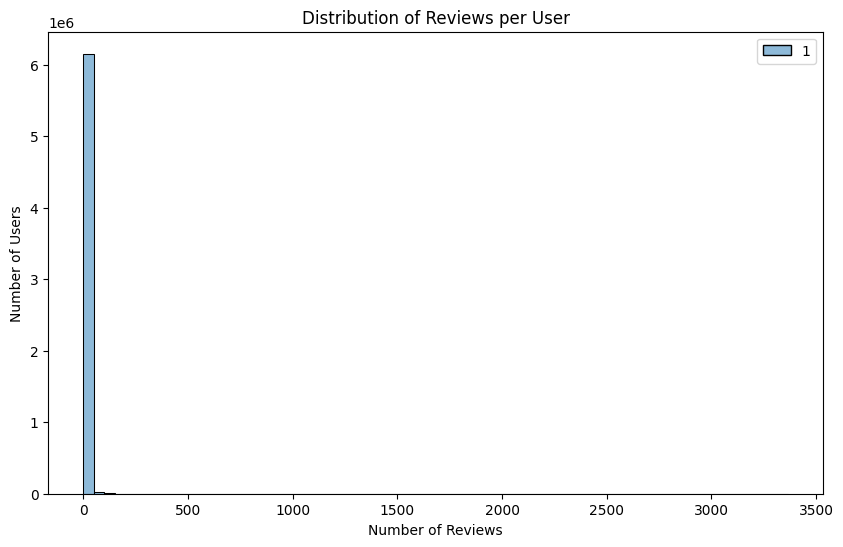

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Load your data into a DataFrame
# df = pd.read_csv('your_data_file.csv')

# Aggregate the data to get the count of reviews per user
review_counts = concatenated_df['reviewerID'].value_counts()

# Set up the matplotlib figure
plt.figure(figsize=(10, 6))

# Plot the histogram with bins of size 50
sns.histplot(review_counts, binwidth=50)

# Adding labels and title for clarity
plt.xlabel('Number of Reviews')
plt.ylabel('Number of Users')
plt.title('Distribution of Reviews per User')

# Show the plot
plt.show()

In [ ]:
import pandas as pd
import plotly.express as px


# Calculate the number of records per reviewerID
df_pd=concatenated_df.to_pandas()
review_counts = df_pd['reviewerID'].value_counts().reset_index()
review_counts.columns = ['reviewerID', 'count']

# Now, review_counts contains the number of times each reviewerID appears in the DataFrame

# Plotting the histogram using Plotly Express
fig = px.histogram(review_counts, x='count', title='Number of Reviews per Reviewer')

# Update the layout if needed
fig.update_layout(xaxis_title='Number of Reviews', yaxis_title='Number of Reviewers')

# Show the plot
fig.show()


In [ ]:
fig.show()

# TODO: move this with explanation

In [ ]:
quantile_066 = review_counts.quantile(0.50)
quantile_067 = review_counts.quantile(0.67)
quantile_099 = review_counts.quantile(0.99)
quantile_100 = review_counts.quantile(1.00)  # This is essentially the max value

# Print the quantile values
print(f"0.66 quantile: {quantile_066}")
print(f"0.67 quantile: {quantile_067}")
print(f"0.99 quantile: {quantile_099}")
print(f"1 quantile (maximum): {quantile_100}")

<ipython-input-32-313532268497>:1: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-32-313532268497>:2: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

<ipython-input-32-313532268497>:3: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



0.66 quantile: count    1.0
Name: 0.5, dtype: float64
0.67 quantile: count    2.0
Name: 0.67, dtype: float64
0.99 quantile: count    32.0
Name: 0.99, dtype: float64
1 quantile (maximum): count    3365.0
Name: 1.0, dtype: float64


<ipython-input-32-313532268497>:4: FutureWarning:

The default value of numeric_only in DataFrame.quantile is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



# TODO: move this with explanation

In [ ]:
len(review_counts[(review_counts["count"]>=5) & (review_counts["count"]<=50)])

869416

# starting using eda to filter using more conditions and developing nlp model based on that

In [ ]:
!pip install polars pyarrow

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 23.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd

from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:


file_path=f"/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/1_book_after_preprocessing.parquet"
df=pd.read_parquet(file_path)

In [ ]:
def pre_process_save_to_parquet_books(number_to_run):
  df_book_raw=pd.read_parquet(f"/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/books_{number_to_run}.parquet", engine='pyarrow')
  df_book_raw_after_preprocessing = df_book_raw.copy()
  df_book_raw_after_preprocessing.drop(columns=["vote", "reviewerName"], inplace=True)

  # Convert "nan", "NaN", "None", and empty strings to np.nan in the new DataFrame
  df_book_raw_after_preprocessing.replace(["nan", "NaN", "None", ""], np.nan, inplace=True)

  # Drop rows with any np.nan values in the new DataFrame
  df_book_raw_after_preprocessing.dropna(inplace=True)
  df_book_raw_after_preprocessing["style"] = df_book_raw_after_preprocessing["style"].astype(str)

  df_book_raw_after_preprocessing.drop_duplicates(keep=False, inplace=True)

  review_counts = df_book_raw_after_preprocessing.groupby(['reviewerID', 'asin']).transform('count')

  # Find rows where the count of reviews for the combination is exactly 1
  single_reviews = review_counts.max(axis=1) == 1

  # Filter the DataFrame to keep only those rows
  df_book_single_reviews = df_book_raw_after_preprocessing[single_reviews]

  df_book_single_reviews.to_parquet(f"/content/drive/MyDrive/books_to_kindle_and_books_parquets/books/{number_to_run}_book_after_preprocessing.parquet")

In [ ]:
  df.drop_duplicates(keep=False, inplace=True)

In [ ]:
df_book_single_reviews=df.head(2000)


In [ ]:
del df
import gc
gc.collect()

0

In [ ]:
df_book_single_reviews.head()

,overall,verified,reviewerID,asin,style,reviewText,summary
0,5,False,A1C6M8LCIX4M6M,0001713353,{'Format:': ' Paperback'},This book is a winner with both of my boys. T...,Children's favorite
1,5,False,A1REUF3A1YCPHM,0001713353,{'Format:': ' Hardcover'},"The King, the Mice and the Cheese by Nancy Gur...",A story children will love and learn from
2,5,False,A1YRBRK2XM5D5,0001713353,{'Format:': ' Hardcover'},My daughter got her first copy from her great-...,Third copy
3,5,False,A1V8ZR5P78P4ZU,0001713353,{'Format:': ' Hardcover'},I remember this book from when I was a child a...,Graphically Wonderful!
4,5,True,ACPQVNRD3Z09X,0001713353,{'Format:': ' Hardcover'},It is a very cute book with great illustration...,Five Stars


In [ ]:

# Suppose 'df_book_single_reviews' is your dataframe
# Group by 'reviewerID' and filter
df_book_single_reviews = df_book_single_reviews.groupby('reviewerID').filter(lambda x: 5 <= len(x) <= 50)

# Now 'filtered_reviews' contains only the reviews where the reviewer has between 5 to 50 reviews


In [ ]:
df_book_single_reviews['text_length'] = df_book_single_reviews['reviewText'].apply(lambda x: len(x.split()))
final_reviews = df_book_single_reviews[df_book_single_reviews['text_length'] <= 50]


In [ ]:
final_reviews.describe(include=["object"])

,reviewerID,asin,style,reviewText,summary
count,1988,1988,1988,1988,1988
unique,1975,26,3,1960,1408
top,A26TU4ONC9KQRR,0001384198,{'Format:': ' Hardcover'},Good,Five Stars
freq,3,757,1643,6,367


In [ ]:
!pip install transformers torch


  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.19.3-py3-none-manylinux1_x86_64.whl (166.0 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (99 kB)
  Using cached nvidia_nvjitlink_cu12-12.4.127-py3-none-m

In [ ]:
from transformers import RobertaModel, RobertaTokenizer

# Load tokenizer and model
tokenizer = RobertaTokenizer.from_pretrained('roberta-base')
model = RobertaModel.from_pretrained('roberta-base')

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
import torch
def extract_features(encoded_reviews):
    # Pass the encoded reviews to the model and get the outputs
    with torch.no_grad():
        outputs = model(**encoded_reviews)
    # Use the pooled output for whole sentence embeddings
    features = outputs.pooler_output
    return features

In [ ]:
def tokenize_reviews(reviews, max_length=512):
    # Tokenize and encode the reviews
    encoded_batch = tokenizer(reviews, padding=True, truncation=True, max_length=max_length, return_tensors="pt")
    return encoded_batch

In [ ]:
import pandas as pd


# Tokenize and extract features
tokenized_reviews = tokenize_reviews(final_reviews['reviewText'].tolist())



In [ ]:
tokenized_reviews

{'input_ids': tensor([[   0,  713, 1040,  ...,    1,    1,    1],
        [   0,  133, 1745,  ...,    1,    1,    1],
        [   0, 2387, 1354,  ...,    1,    1,    1],
        ...,
        [   0,  534, 4097,  ...,    1,    1,    1],
        [   0,  100,   74,  ...,    1,    1,    1],
        [   0,  170, 2162,  ...,    1,    1,    1]]), 'attention_mask': tensor([[1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        ...,
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0],
        [1, 1, 1,  ..., 0, 0, 0]])}

In [ ]:
features = extract_features(tokenized_reviews)

# Convert features to a DataFrame (if needed)
features_df = pd.DataFrame(features.numpy())

In [ ]:
features_df.describe(include=["object"])

# TODO: modify path to use the eda function instead of the specific path

In [ ]:
df.describe(include=["object"])

,reviewerID,asin,style,reviewText,summary
count,3688496,3688496,3688496,3688496,3688496
unique,2114988,70307,3,3445842,2281913
top,A2F6N60Z96CAJI,000711835X,{'Format:': ' Paperback'},Great,Five Stars
freq,3090,7118,1744435,5163,419334
